# Object Detection with ResNet model

In [1]:
# Created by M. Massenzio, 2024-02-28
# See: https://huggingface.co/facebook/detr-resnet-50

from transformers import DetrImageProcessor, DetrForObjectDetection
from IPython.display import display
import torch

# Utility methods
from common import load_image, draw_boxes, model2pipeline_results


## Loading the Model directly

The code below loads a pre-trained ResNet model (FB DETR) and uses it to detect objects in the image.

In [2]:
image = load_image('file://racetrack.jpeg')

image_processor = DetrImageProcessor.from_pretrained("facebook/detr-resnet-50")
model = DetrForObjectDetection.from_pretrained("facebook/detr-resnet-50")

inputs = image_processor(images = image, return_tensors = "pt")
outputs = model(**inputs)


The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a Ber

In [3]:
target_sizes = torch.tensor([image.size[::-1]])
results = image_processor.post_process_object_detection(
              outputs,
              target_sizes = target_sizes,
              threshold = 0.7)[0]
results

{'scores': tensor([0.9287, 0.9983, 0.9965, 0.9957, 0.9965, 0.9964, 0.9986, 0.9961, 0.8259,
         0.9962, 0.9990, 0.9975], grad_fn=<IndexBackward0>),
 'labels': tensor([ 3,  3,  3,  3,  1,  3,  3,  3, 13,  3,  3,  3]),
 'boxes': tensor([[1.8165e+03, 1.6792e+03, 2.0276e+03, 1.7291e+03],
         [1.6183e+03, 1.8816e+03, 2.2350e+03, 2.1154e+03],
         [3.5102e+03, 1.9478e+03, 4.0315e+03, 2.2454e+03],
         [3.4825e+03, 2.3501e+03, 4.0318e+03, 2.7839e+03],
         [3.8093e+03, 2.4660e+03, 4.0322e+03, 2.9411e+03],
         [1.1331e+03, 1.8700e+03, 1.6477e+03, 2.0610e+03],
         [8.7105e+02, 2.0388e+03, 1.6858e+03, 2.3788e+03],
         [7.5245e-01, 1.9645e+03, 3.7328e+02, 2.2171e+03],
         [2.9129e+03, 1.5908e+03, 2.9975e+03, 1.6829e+03],
         [1.9011e+02, 1.9845e+03, 8.4488e+02, 2.2681e+03],
         [1.6840e+03, 2.0879e+03, 2.7755e+03, 2.5203e+03],
         [2.3830e+03, 1.8941e+03, 3.1610e+03, 2.1693e+03]],
        grad_fn=<IndexBackward0>)}

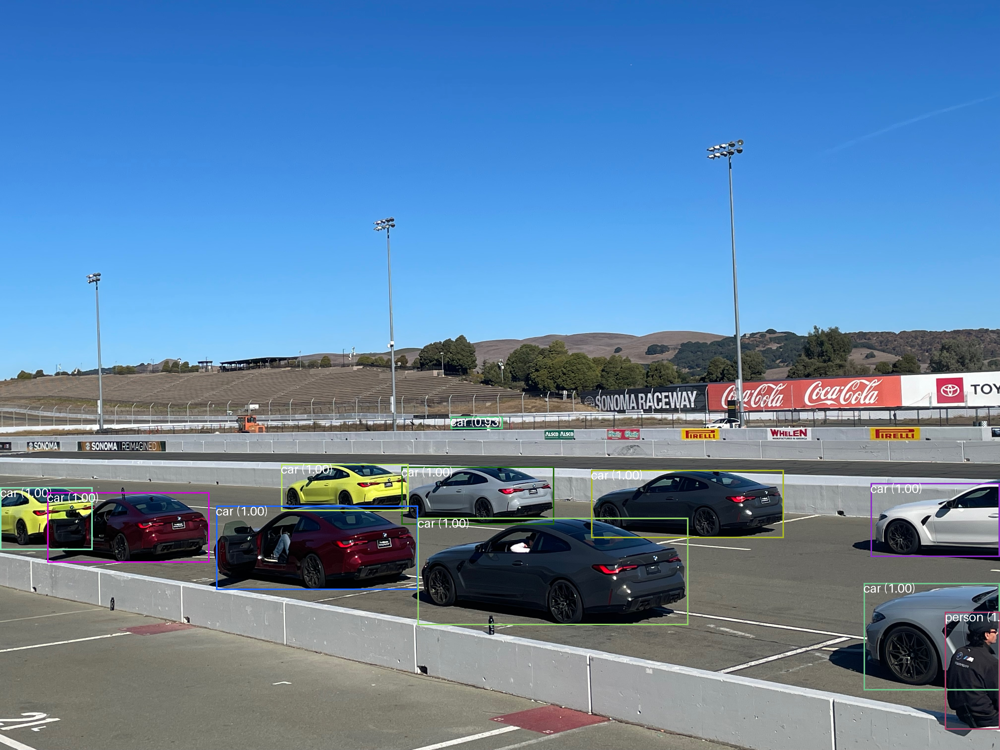

In [4]:
draw_boxes(image, model2pipeline_results(results, model))
display(image)

## Using Hugging Face transformers Pipeline

In [5]:
from transformers import pipeline

image = load_image('file://racetrack.jpeg')

detection = pipeline("object-detection", model="facebook/detr-resnet-50")
results = detection(image)
results[:3]


Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Could not find image processor class in the image processor config or the model conf

[{'score': 0.9286917448043823,
  'label': 'car',
  'box': {'xmin': 1816, 'ymin': 1679, 'xmax': 2027, 'ymax': 1729}},
 {'score': 0.9982571005821228,
  'label': 'car',
  'box': {'xmin': 1618, 'ymin': 1881, 'xmax': 2234, 'ymax': 2115}},
 {'score': 0.9964500665664673,
  'label': 'car',
  'box': {'xmin': 3510, 'ymin': 1947, 'xmax': 4031, 'ymax': 2245}}]

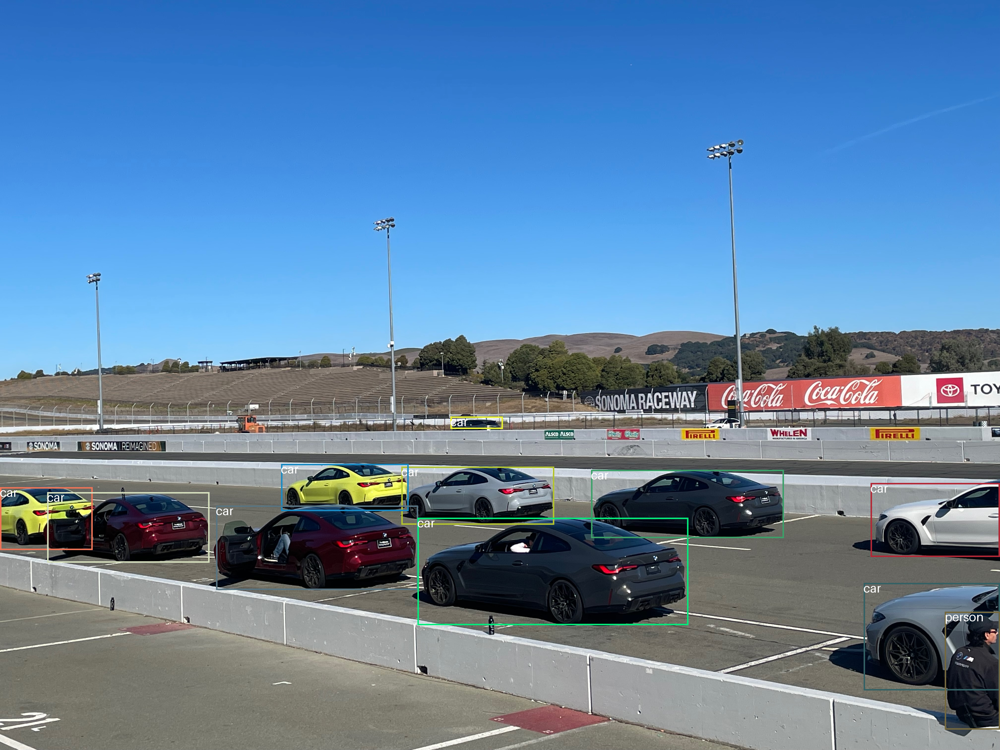

In [6]:
draw_boxes(image, results)
display(image)